Code for **"Inpainting"** figures $6$, $8$ and 7 (top) from the main paper. 

In [33]:
"""
*Uncomment if running on colab* 
Set Runtime -> Change runtime type -> Under Hardware Accelerator select GPU in Google Colab 
"""
# !git clone https://github.com/DmitryUlyanov/deep-image-prior
# !mv deep-image-prior/* ./

'\n*Uncomment if running on colab* \nSet Runtime -> Change runtime type -> Under Hardware Accelerator select GPU in Google Colab \n'

# Import libs

In [34]:
from __future__ import print_function
import matplotlib.pyplot as plt
%matplotlib inline

import os
# os.environ['CUDA_VISIBLE_DEVICES'] = '1'

import numpy as np
from models.resnet import ResNet
from models.unet import UNet
from models.skip import skip
import torch
import torch.optim

from utils.inpainting_utils import *

torch.backends.cudnn.enabled = True
torch.backends.cudnn.benchmark =True
dtype = torch.cuda.FloatTensor

PLOT = True
imsize = -1
dim_div_by = 64

# Choose figure

In [35]:
## Fig 6
# img_path  = 'data/inpainting/vase.png'
# mask_path = 'data/inpainting/vase_mask.png'

## Fig 8
# img_path  = 'data/inpainting/library.png'
# mask_path = 'data/inpainting/library_mask.png'

## Fig 7 (top)
img_path  = 'data/inpainting/cleantrail.jpg'
mask_path = 'data/inpainting/kate_mask.png'

# Another text inpainting example
# img_path  = 'data/inpainting/peppers.png'
# mask_path = 'data/inpainting/peppers_mask.png'

NET_TYPE = 'skip_depth6' # one of skip_depth4|skip_depth2|UNET|ResNet

C:\Users\Gautham\AppData\Local\Temp\ipykernel_12272\3712802294.py:17: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img_new_resized = img_new.resize(mask_img.size, Image.ANTIALIAS)


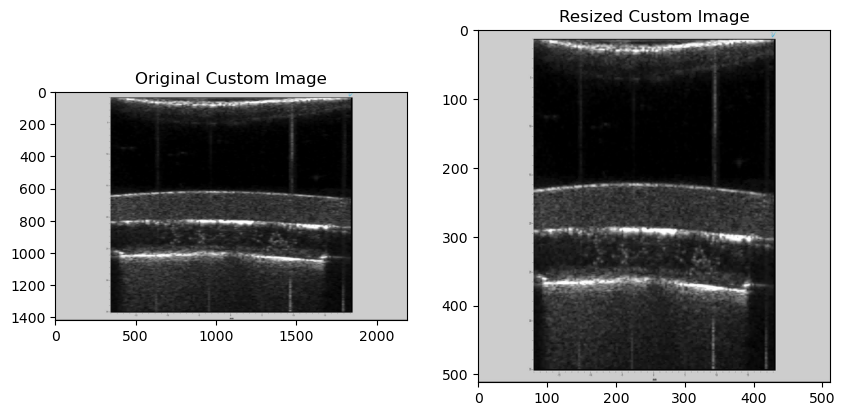

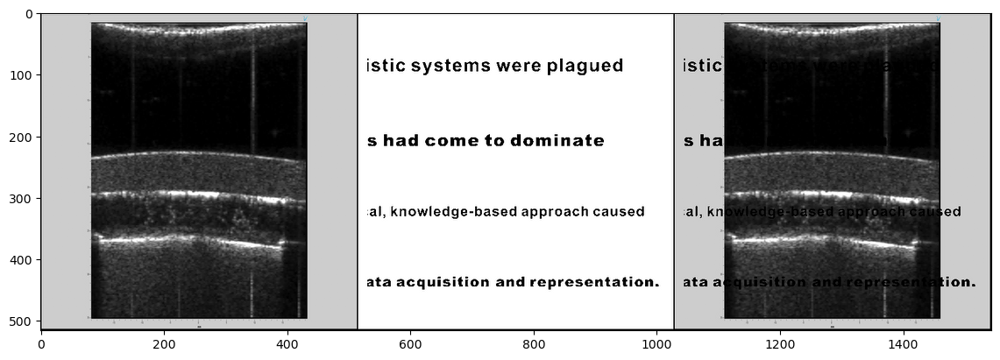

array([[[0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.8039216 , ..., 0.8039216 ,
         0.        , 0.        ],
        ...,
        [0.        , 0.        , 0.53333336, ..., 0.53333336,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ]],

       [[0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.8039216 , ..., 0.8039216 ,
         0.        , 0.        ],
        ...,
        [0.        , 0.        , 0.53333336, ..., 0.53333336,
         0.        , 0.        ],
        [0. 

In [36]:
from PIL import Image
import numpy as np
import torch
from utils.inpainting_utils import *

# Paths to images
img_path = 'data/inpainting/cleantrail.jpg'
mask_path = 'data/inpainting/kate_mask.png'

# Load your custom image
img_new = Image.open(img_path)

# Load the mask image provided in the GitHub repo
mask_img = Image.open(mask_path)

# Resize the custom image to match the size of the mask
img_new_resized = img_new.resize(mask_img.size, Image.ANTIALIAS)

# Convert the resized custom image to NumPy array
img_new_np = pil_to_np(img_new_resized)

# Display the original custom image and resized image
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title("Original Custom Image")
plt.imshow(img_new)
plt.subplot(1, 2, 2)
plt.title("Resized Custom Image")
plt.imshow(img_new_resized)
plt.show()

# Load the original mask image and convert to NumPy array
img_mask_pil, img_mask_np = get_image(mask_path, imsize)
img_mask_pil = crop_image(img_mask_pil, dim_div_by)
img_mask_np = pil_to_np(img_mask_pil)

# Convert the mask to PyTorch tensor
img_mask_var = np_to_torch(img_mask_np).type(dtype)

# Plot the images
plot_image_grid([img_new_np, img_mask_np, img_mask_np * img_new_np], 3, 11)



In [37]:
#from PIL import Image

# Load your custom image
#img_path_new  = 'data/inpainting/cleantrail.jpg'
#img_new = Image.open(img_path_new)

# Load the mask image provided in the GitHub repo
#mask_path = 'data/inpainting/kate_mask.png'
#mask_img = Image.open(mask_path)

# Resize the custom image to match the size of the mask
#img_new_resized = img_new.resize(mask_img.size, Image.ANTIALIAS)

# Convert the resized custom image to NumPy array
#img_new_np = pil_to_np(img_new_resized)

# Now you can use custom_img_np in your code
# ...

# If needed, you can visualize the resized custom image
#plt.imshow(custom_img_resized)
#plt.title("Resized Custom Image")
#plt.show()


# Load mask

In [38]:
#img_pil, img_np = get_image(img_path, imsize)
#img_mask_pil, img_mask_np = get_image(mask_path, imsize)

### Center crop

In [39]:
#img_mask_pil = crop_image(img_mask_pil, dim_div_by)
#img_pil      = crop_image(img_pil,      dim_div_by)

#img_np      = pil_to_np(img_pil)
#img_mask_np = pil_to_np(img_mask_pil)

### Visualize

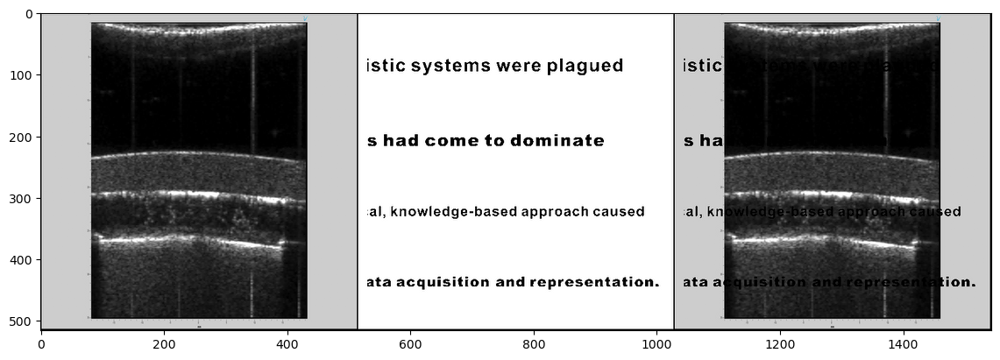

array([[[0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.8039216 , ..., 0.8039216 ,
         0.        , 0.        ],
        ...,
        [0.        , 0.        , 0.53333336, ..., 0.53333336,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ]],

       [[0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.8039216 , ..., 0.8039216 ,
         0.        , 0.        ],
        ...,
        [0.        , 0.        , 0.53333336, ..., 0.53333336,
         0.        , 0.        ],
        [0. 

In [40]:
img_mask_var = np_to_torch(img_mask_np).type(dtype)

plot_image_grid([img_new_np, img_mask_np, img_mask_np * img_new_np], 3, 11)


# Setup

In [41]:
pad = 'reflection' # 'zero'
OPT_OVER = 'net'
OPTIMIZER = 'adam'

In [44]:
if 'vase.png' in img_path:
    INPUT = 'meshgrid'
    input_depth = 2
    LR = 0.01 
    num_iter = 5001
    param_noise = False
    show_every = 50
    figsize = 5
    reg_noise_std = 0.03
    
    net = skip(input_depth, img_new_np.shape[0], 
               num_channels_down = [128] * 5,
               num_channels_up   = [128] * 5,
               num_channels_skip = [0] * 5,  
               upsample_mode='nearest', filter_skip_size=1, filter_size_up=3, filter_size_down=3,
               need_sigmoid=True, need_bias=True, pad=pad, act_fun='LeakyReLU').type(dtype)
    
elif ('cleantrail.jpg' in img_path) or ('peppers.png' in img_path):
    # Same params and net as in super-resolution and denoising
    INPUT = 'noise'
    input_depth = 32
    LR = 0.01 
    num_iter = 6001
    param_noise = False
    show_every = 50
    figsize = 5
    reg_noise_std = 0.03
    
    net = skip(input_depth, img_new_np.shape[0], 
               num_channels_down = [128] * 5,
               num_channels_up =   [128] * 5,
               num_channels_skip =    [128] * 5,  
               filter_size_up = 3, filter_size_down = 3, 
               upsample_mode='nearest', filter_skip_size=1,
               need_sigmoid=True, need_bias=True, pad=pad, act_fun='LeakyReLU').type(dtype)
    
elif 'library.png' in img_path:
    
    INPUT = 'noise'
    input_depth = 1
    
    num_iter = 3001
    show_every = 50
    figsize = 8
    reg_noise_std = 0.00
    param_noise = True
    
    if 'skip' in NET_TYPE:
        
        depth = int(NET_TYPE[-1])
        net = skip(input_depth, img_new_np.shape[0], 
               num_channels_down = [16, 32, 64, 128, 128, 128][:depth],
               num_channels_up =   [16, 32, 64, 128, 128, 128][:depth],
               num_channels_skip =    [0, 0, 0, 0, 0, 0][:depth],  
               filter_size_up = 3,filter_size_down = 5,  filter_skip_size=1,
               upsample_mode='nearest', # downsample_mode='avg',
               need1x1_up=False,
               need_sigmoid=True, need_bias=True, pad=pad, act_fun='LeakyReLU').type(dtype)
        
        LR = 0.01 
        
    elif NET_TYPE == 'UNET':
        
        net = UNet(num_input_channels=input_depth, num_output_channels=3, 
                   feature_scale=8, more_layers=1, 
                   concat_x=False, upsample_mode='deconv', 
                   pad='zero', norm_layer=torch.nn.InstanceNorm2d, need_sigmoid=True, need_bias=True)
        
        LR = 0.001
        param_noise = False
        
    elif NET_TYPE == 'ResNet':
        
        net = ResNet(input_depth, img_new_np.shape[0], 8, 32, need_sigmoid=True, act_fun='LeakyReLU')
        
        LR = 0.001
        param_noise = False
        
    else:
        assert False
else:
    assert False

net = net.type(dtype)
net_input = get_noise(input_depth, INPUT, img_new_np.shape[1:]).type(dtype)

In [45]:
# Compute number of parameters
s  = sum(np.prod(list(p.size())) for p in net.parameters())
print ('Number of params: %d' % s)

# Loss
mse = torch.nn.MSELoss().type(dtype)

img_var = np_to_torch(img_new_np).type(dtype)
mask_var = np_to_torch(img_mask_np).type(dtype)

Number of params: 3002627


# Main loop

Starting optimization with ADAM


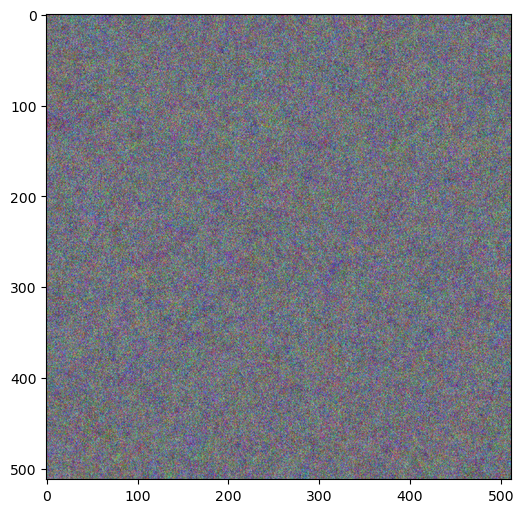

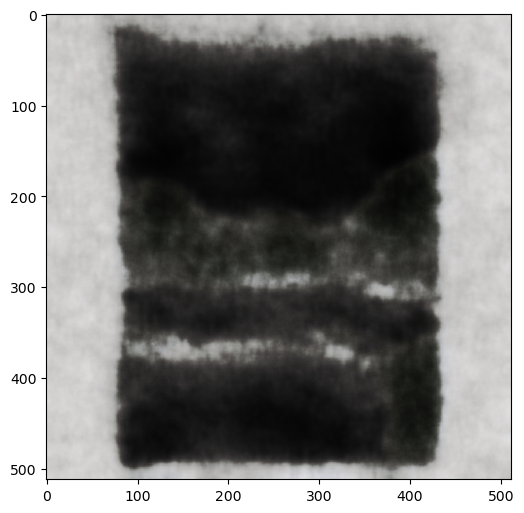

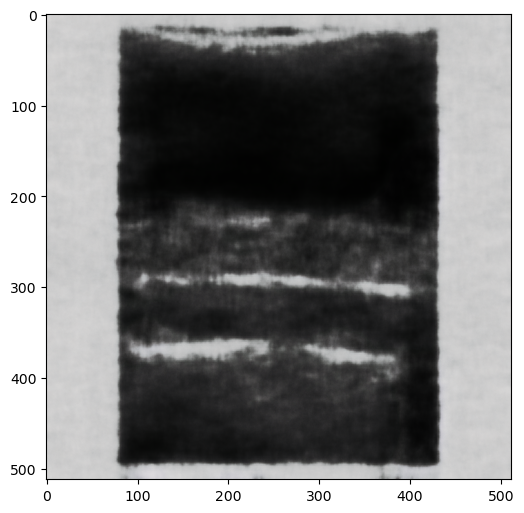

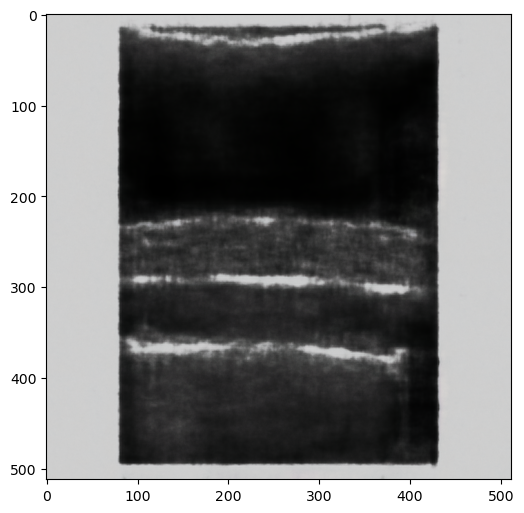

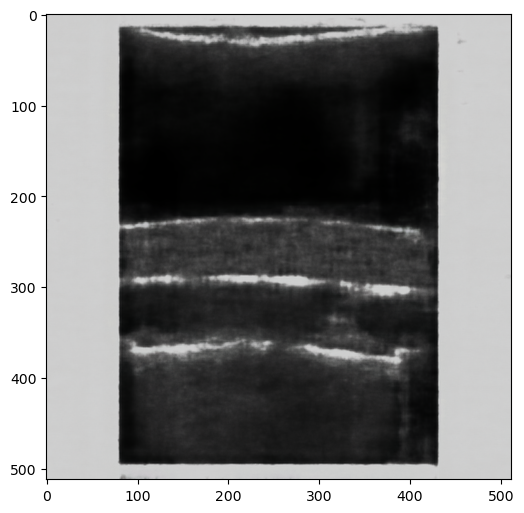

...

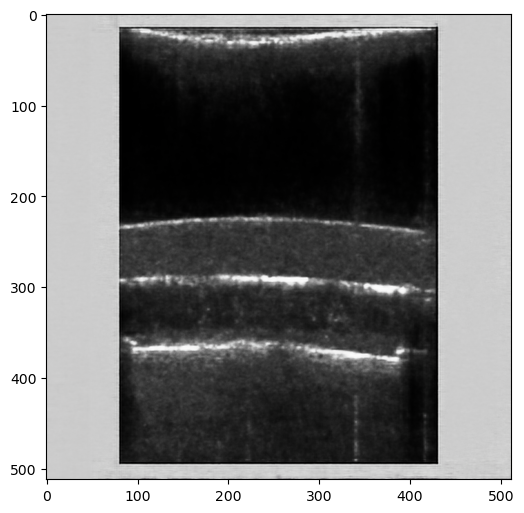

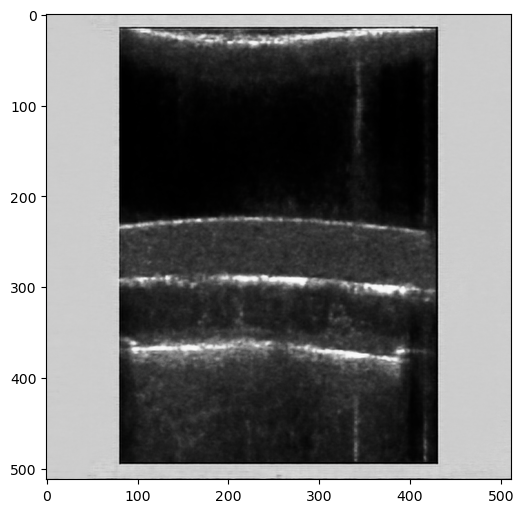

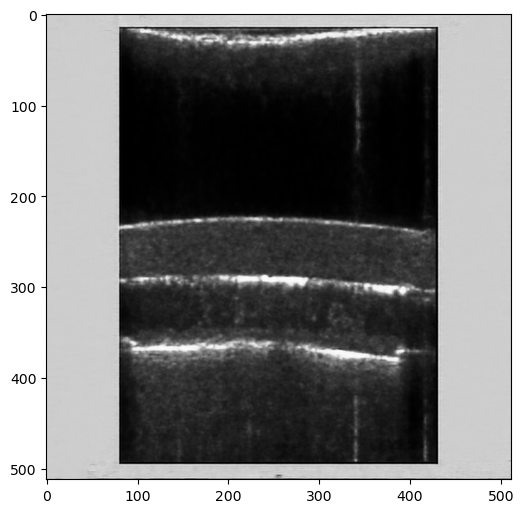

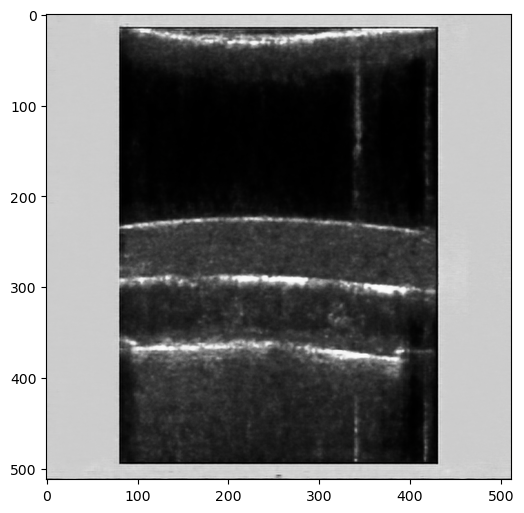

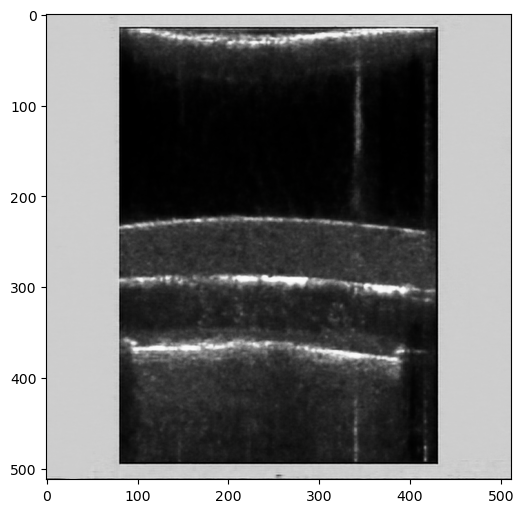

In [46]:
i = 0
def closure():
    
    global i
    
    if param_noise:
        for n in [x for x in net.parameters() if len(x.size()) == 4]:
            n = n + n.detach().clone().normal_() * n.std() / 50
    
    net_input = net_input_saved
    if reg_noise_std > 0:
        net_input = net_input_saved + (noise.normal_() * reg_noise_std)
        
        
    out = net(net_input)
   
    total_loss = mse(out * mask_var, img_var * mask_var)
    total_loss.backward()
        
    print ('Iteration %05d    Loss %f' % (i, total_loss.item()), '\r', end='')
    if  PLOT and i % show_every == 0:
        out_np = torch_to_np(out)
        plot_image_grid([np.clip(out_np, 0, 1)], factor=figsize, nrow=1)
        
    i += 1

    return total_loss

net_input_saved = net_input.detach().clone()
noise = net_input.detach().clone()

p = get_params(OPT_OVER, net, net_input)
optimize(OPTIMIZER, p, closure, LR, num_iter)

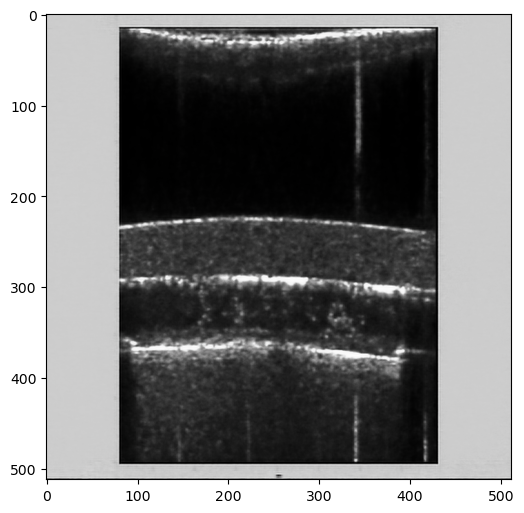

In [47]:
out_np = torch_to_np(net(net_input))
plot_image_grid([out_np], factor=5);

In [48]:
## Fig 6
# img_path  = 'data/inpainting/vase.png'
# mask_path = 'data/inpainting/vase_mask.png'

## Fig 8
# img_path  = 'data/inpainting/library.png'
# mask_path = 'data/inpainting/library_mask.png'

## Fig 7 (top)
img_path  = 'data/inpainting/trail2.jpg'
mask_path = 'data/inpainting/kate_mask.png'

# Another text inpainting example
# img_path  = 'data/inpainting/peppers.png'
# mask_path = 'data/inpainting/peppers_mask.png'

NET_TYPE = 'skip_depth6' # one of skip_depth4|skip_depth2|UNET|ResNet

C:\Users\Gautham\AppData\Local\Temp\ipykernel_12272\489927074.py:17: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img_new_resized = img_new.resize(mask_img.size, Image.ANTIALIAS)


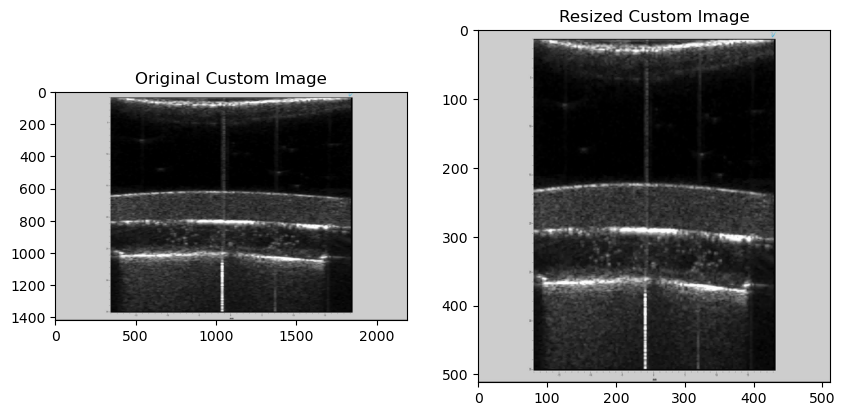

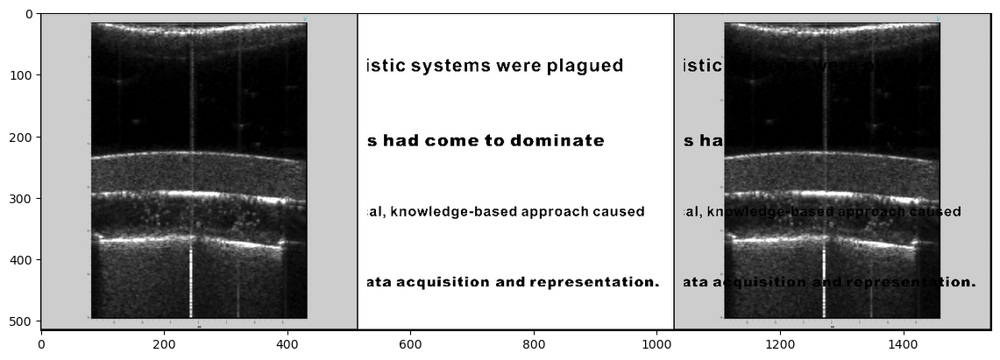

array([[[0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.8039216 , ..., 0.8039216 ,
         0.        , 0.        ],
        ...,
        [0.        , 0.        , 0.53333336, ..., 0.53333336,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ]],

       [[0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.        , ..., 0.        ,
         0.        , 0.        ],
        [0.        , 0.        , 0.8039216 , ..., 0.8039216 ,
         0.        , 0.        ],
        ...,
        [0.        , 0.        , 0.53333336, ..., 0.53333336,
         0.        , 0.        ],
        [0. 

In [50]:
from PIL import Image
import numpy as np
import torch
from utils.inpainting_utils import *

# Paths to images
img_path = 'data/inpainting/trail2.jpg'
mask_path = 'data/inpainting/kate_mask.png'

# Load your custom image
img_new = Image.open(img_path)

# Load the mask image provided in the GitHub repo
mask_img = Image.open(mask_path)

# Resize the custom image to match the size of the mask
img_new_resized = img_new.resize(mask_img.size, Image.ANTIALIAS)

# Convert the resized custom image to NumPy array
img_new_np = pil_to_np(img_new_resized)

# Display the original custom image and resized image
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title("Original Custom Image")
plt.imshow(img_new)
plt.subplot(1, 2, 2)
plt.title("Resized Custom Image")
plt.imshow(img_new_resized)
plt.show()

# Load the original mask image and convert to NumPy array
img_mask_pil, img_mask_np = get_image(mask_path, imsize)
img_mask_pil = crop_image(img_mask_pil, dim_div_by)
img_mask_np = pil_to_np(img_mask_pil)

# Convert the mask to PyTorch tensor
img_mask_var = np_to_torch(img_mask_np).type(dtype)

# Plot the images
plot_image_grid([img_new_np, img_mask_np, img_mask_np * img_new_np], 3, 11)



In [52]:
img_new_np.shape

(3, 512, 512)

In [53]:
net_input.shape

torch.Size([1, 32, 512, 512])

In [56]:
net_input = get_noise(input_depth, INPUT, img_new_np.shape[1:]).type(dtype)

In [55]:
torch.tensor(img_new_np).unsqueeze(dim=0).shape

torch.Size([1, 3, 512, 512])

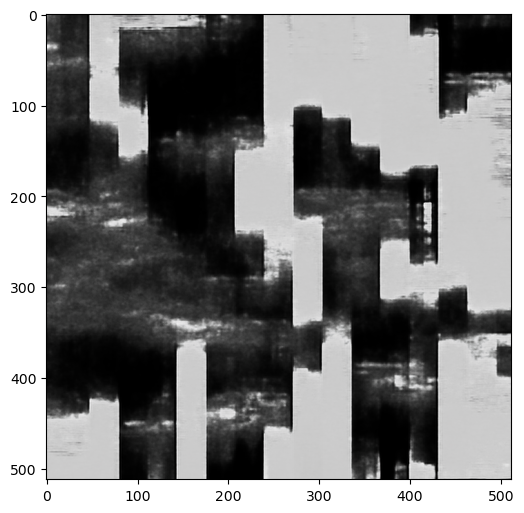

In [59]:
out_np = torch_to_np(net(net_input))
plot_image_grid([out_np], factor=5);